In [6]:
import numpy as np
import h5py
import matplotlib.pylab as plt
import sys
import plotly.express as px
import plotly.offline as py
import plotly.graph_objects as go
import plotly.io as pio
import seaborn as sns
sys.path.append('../../src/')

from tqdm import tqdm
from torch.utils.data import DataLoader
from IPython.core.interactiveshell import InteractiveShell
InteractiveShell.ast_node_interactivity = "all"

# custom scripts
import mri_cs
from visualization import plot_batch
from helpers import signal_to_error
from spiraltrajectory import spiral_samples_trajectory, kspace_measurements_spiral, minimum_energy_reconstruction

layout = go.Layout(template="plotly_dark")
fig = go.Figure(layout=layout)
templated_fig = pio.to_templated(fig)
pio.templates['my_template'] = templated_fig.layout.template
pio.templates.default = 'my_template'

py.init_notebook_mode()

In [10]:
N = 256
DATA_PATH = '/home/gabrielziegler/FastMRIData/singlecoil_challenge/'
FILE_SAMPLE = DATA_PATH + 'file1000019.h5'

hf = h5py.File(FILE_SAMPLE, mode='r')
list(hf.keys())
dict(hf.attrs)

['ismrmrd_header', 'kspace', 'mask']

{'acceleration': 4,
 'acquisition': 'CORPDFS_FBK',
 'num_low_frequency': 30,
 'patient_id': '2d0489e0ebd57e2ee461661f519903e5d77a5c66d41f1993b9a097aea32d4398'}

In [2]:
IMG_PATH = '../../data/scanVisit__0003__0003/MRI__0001/t2/Native/Original__0001/NIFTI/f0001.img'
HEADER_PATH = '../../data/scanVisit__0003__0003/MRI__0001/t2/Native/Original__0001/NIFTI/f0001.hdr'
N = 256

imgs = nib.load(IMG_PATH)
data = imgs.get_fdata()
img = data.T[0]

# Filters

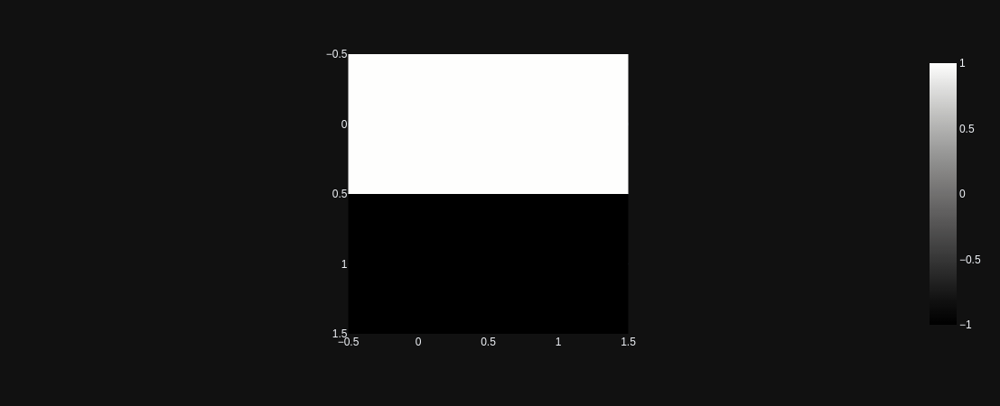

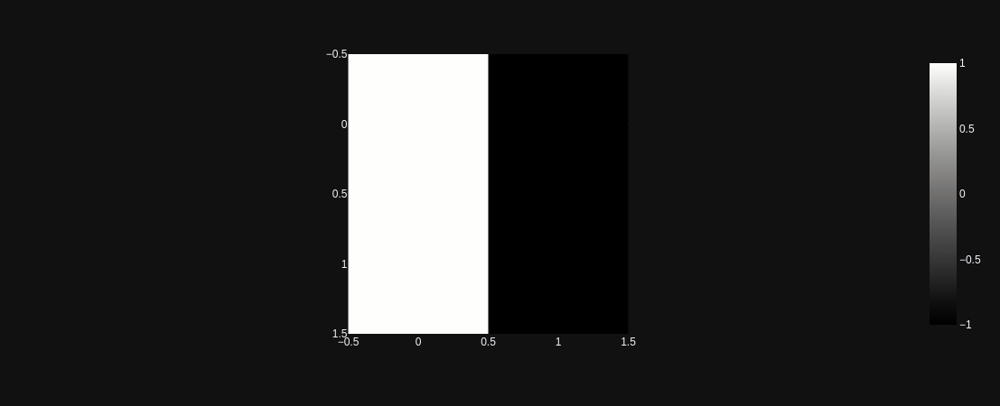

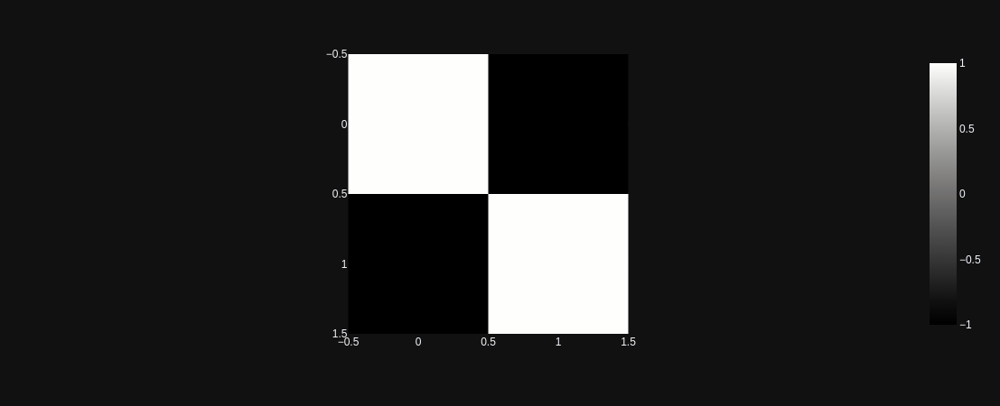

In [3]:
filter1 = np.array([[1, 1], [-1, -1]])
filter2 = filter1.copy().T
filter3 = np.array([[1, -1], [-1, 1]])

initial_filters = [filter1, filter2, filter3]
for f in initial_filters:
    px.imshow(f, color_continuous_scale="gray")

# Sample image used: Shepp-Logan

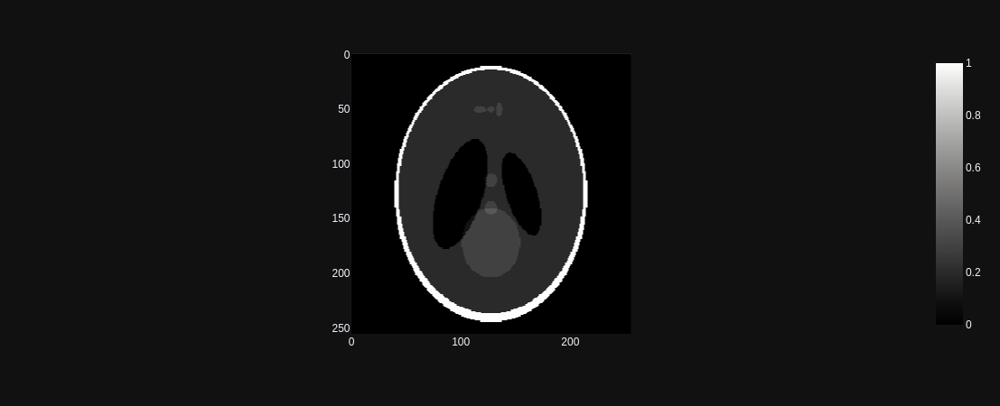

In [4]:
from phantominator import shepp_logan

phantoma = shepp_logan(256)
px.imshow(phantoma, color_continuous_scale="gray")

# Sparsifying filters

3

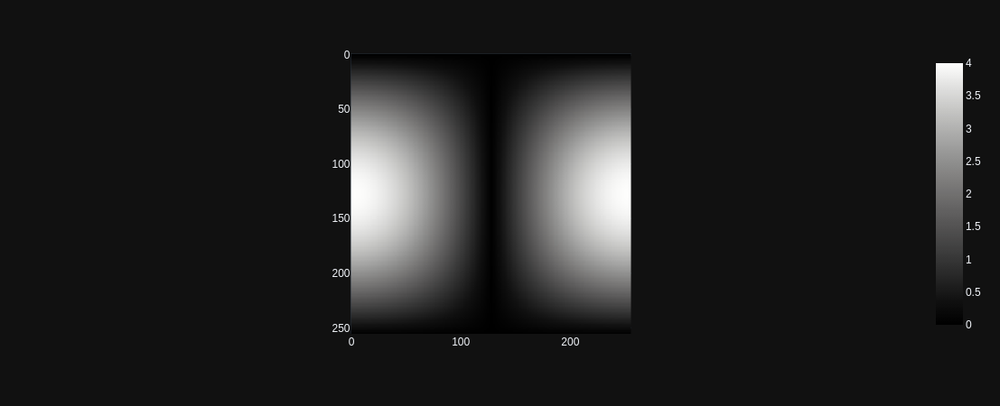

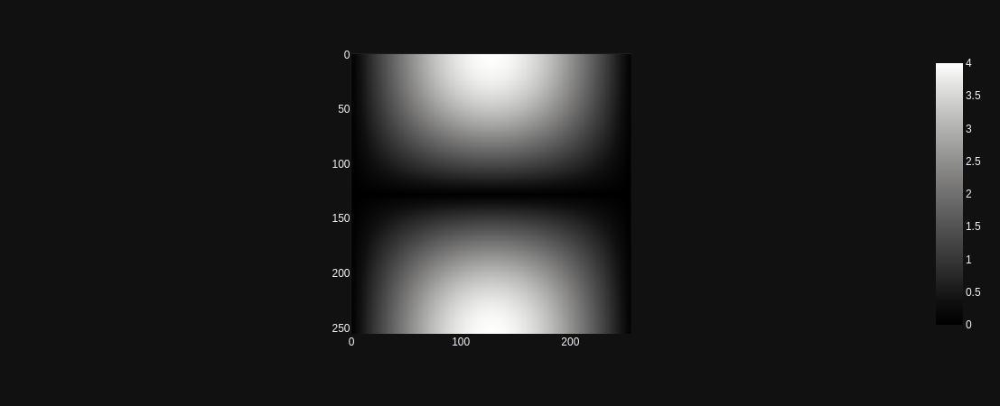

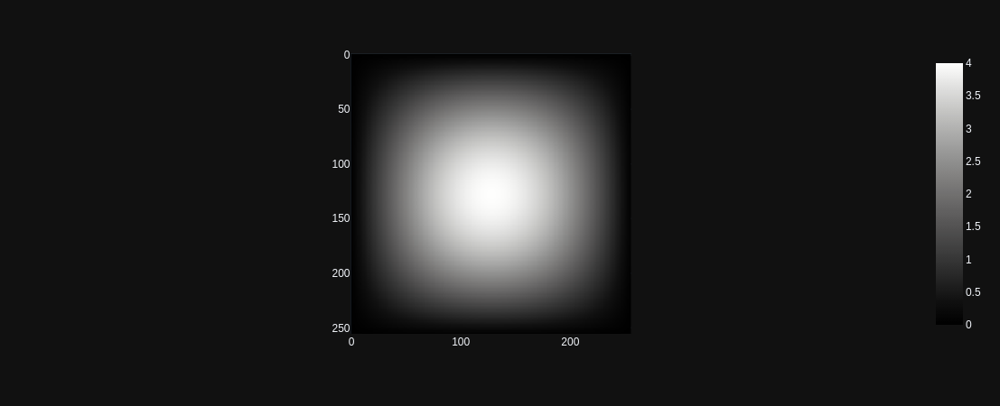

In [5]:
filters = [np.fft.fft2(f, s=(N, N)) for f in initial_filters]
len(filters)
for f in filters:
    px.imshow(np.abs(f), color_continuous_scale="gray")

# K-space Spiral Trajectory

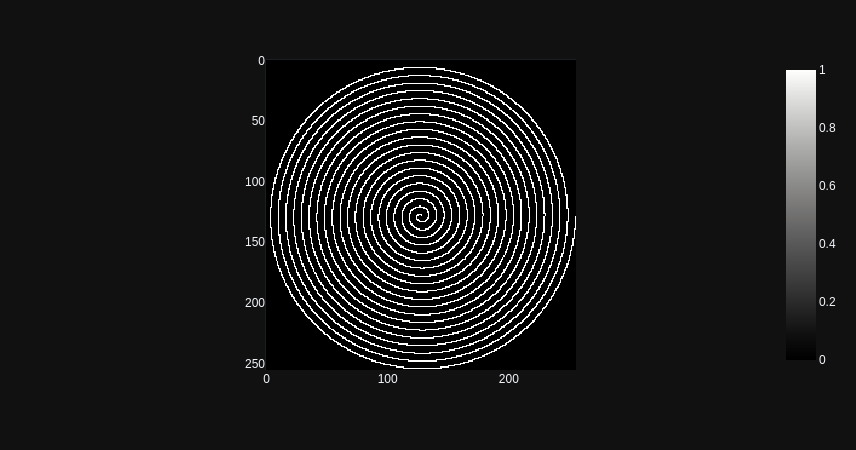

In [17]:
img_size = 256
samples_rows, i, j, I =  spiral_samples_trajectory(width=img_size, height=img_size, n_turns=20)

px.imshow(np.fft.fftshift(I), color_continuous_scale='gray')

In [18]:
b = np.fft.fft2(phantoma).flatten()[samples_rows]
b
b.size

array([ 8044.          +0.j        ,   374.50413812 -56.2712739j ,
         306.65139035 -21.2217625j , ...,  1104.03684494+287.14291749j,
        1243.7043627 -338.27709334j, -1087.063037  +541.89256098j])

10173

In [19]:
def filter_sparsify(b, filters: list, samples_rows: np.array):
    # flatten each filter 
    stacked_filters = [f.flatten() for f in filters]
    stacked_filters = [f[samples_rows] for f in stacked_filters]
    
    print(len(stacked_filters))
    print(len(stacked_filters[0]))
    # reshape filters to NxN
#     H = [np.reshape(h, (N, N)) for h in stacked_filters]
    # Multiply each filter with the image b element-wise: Bf in paper
    Bfs = [h * b.flatten() for h in stacked_filters]
    
    return Bfs

bfs = filter_sparsify(b, filters, samples_rows)

3
10173


In [20]:
len(bfs)
bfs[0].shape
# plt.imshow(np.abs(np.reshape(bfs, (N, N))))

3

(10173,)

# Image composition after applying filters

In [21]:
img_size = N

# reconstrucao do sinal a partir das medidas
A_ = lambda x: np.fft.fft2(np.reshape(x, (img_size, img_size))).flatten()[samples_rows]

def a(x):
    signal = np.reshape(x, (img_size, img_size))
    signal = np.fft.fft2(signal)
    signal = signal.flatten()[samples_rows]
    return signal

def ah(x):
    x = fill_with_zeros(x, samples_rows, img_size)
    x = np.fft.ifft2(x)
    x = x * (img_size * img_size)
    x = x.flatten()
    return x

def fill_with_zeros(x, samples_rows, img_size):
    y = np.zeros((img_size * img_size), dtype=complex)

    y[samples_rows] = x
    y = np.reshape(y, (img_size, img_size))
    return y
    
def reconstruct_from_filters(bfs, samples_rows):
    reconstructed_imgs = []
    
    for bf in tqdm(bfs):
        res = mri_cs.lpminimization(A_, Ah=ah, b=bf, p=1, N=(img_size * img_size), verbose=False)
        reconstructed_imgs.append(res)
        
    return reconstructed_imgs

In [22]:
reconstructed_imgs = reconstruct_from_filters(bfs, samples_rows)

100%|██████████| 3/3 [23:53<00:00, 477.95s/it]


In [23]:
def compose(b, filters, reconstructed_imgs, samples_rows):
    composition = np.zeros((N*N,), dtype=complex)
    composition[samples_rows] = b

    filters = [f.flatten() for f in filters]
    reconstructed_imgs = [np.reshape(recon_img, (N, N)) for recon_img in reconstructed_imgs]
    imgs_hat = [np.fft.fft2(recon_img).flatten() for recon_img in reconstructed_imgs]
    filters_distribution = []
    test = []
    for idx, elem in enumerate(composition):
        if idx not in samples_rows:
            # get element in index from each filter in its absolute form
            abs_filter_values = np.array([np.abs(f[idx]) for f in filters])
            # Identify from which filter the value is higher in absolute form
            best_filter_idx = np.argmax(abs_filter_values)
            # Append selected filter for analysis
            filters_distribution.append(best_filter_idx)
            # Get element from best filter
            filter_elem = filters[best_filter_idx][idx]
            if filter_elem == 0:
                continue
            best_generate_img_elem = imgs_hat[best_filter_idx][idx]
            test.append(best_generate_img_elem)
            # Divide element in matrix created by best-valued filter by the value in the filter   
            fill_value = best_generate_img_elem / filter_elem
            composition[idx] = fill_value
        else:
            composition[idx] = elem
            
    filters_distribution = np.unique(filters_distribution, return_counts=True)
    print(f'The filters\' distribution is: {filters_distribution}')
    composition = np.reshape(composition, (N, N))
    composition = np.fft.ifft2(composition)
    return composition

In [24]:
composed_image = compose(b, filters, reconstructed_imgs, samples_rows)

The filters' distribution is: (array([0, 1, 2]), array([20183, 20115, 15065]))


(256, 256)

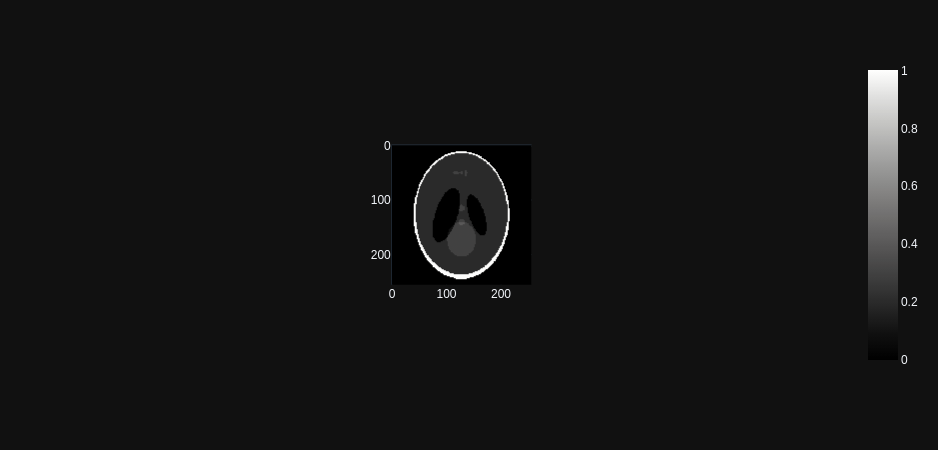

In [29]:
composed_image.shape

px.imshow(np.abs(composed_image), color_continuous_scale="gray")

In [26]:
def signal_to_error(ground_truth, reconstructed_signal):
    err = reconstructed_signal - ground_truth
    # energy: sum of the square of the modulus
    signal_energy = np.sum(np.abs(ground_truth) ** 2)
    error_energy = np.sum(np.abs(err) ** 2)
    signal_error_ratio = signal_energy / error_energy
    # calculate in decibels
    ser_db = 10 * np.log10(signal_error_ratio)

    return signal_error_ratio, ser_db

signal_to_error(composed_image, composed_image - phantoma)

(1750347.182033565, 62.431241997073485)

In [27]:
from skimage.metrics import structural_similarity as ssim

ssim(phantoma, np.real(composed_image))

0.9999985119805125